<a href="https://colab.research.google.com/github/devvratin/bootstrapbydevvrat/blob/main/dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🐶🐶🐶Using Transfer Learning and TensorFlow 2.0 to Classify different Dog Breeeds
Who's that doggy in the window?
To do this , we'll be using data from the Kaggel dog breed identifation competition. It consists of a collection of 10000+ labelled images of 120 different dog breeds.
This kind of problem is called multi-class image classification .
--> We're going to go through the following TensorFlow/
We will be working on [Dog Breed Identification ](https://www.kaggle.com/c/dog-breed-identification/overview)

# End-to-end Multi-class Dog Breed Classification
This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.0 and TensorFlow Hub.

## 1. Problem
Identifying the dog breed with the given image.

--> When I am seating at the cafe and want to predict the correct breed of a dog by taking and uploading its photo.

## 2. DaTa
The data we're using is from Kaggle's [Dog breed identification](https://www.kaggle.com/competitions/dog-breed-identification/data).


## 3. Evaluation
The [evaluation](https://www.kaggle.com/competitions/dog-breed-identification/overview/evaluation) is a file with prediction probabilities for each dog breed of each test image.

## 4. Features
Some info about the data:
* We are dealing with the unstructured data (images) so we use deep learning/transfer learning.
*  There are 120 breeds of dogs ( means total are 120 different classes for classification )
* There are around 10k+ images in the training set with labels
* There are around 10k+ images in the test set which are not labeled which we have to predict .

In [7]:
!unzip "/content/drive/MyDrive/DataSet/Dog Vision/dog-breed-identification.zip"

Streaming output truncated to the last 5000 lines.
  inflating: train/83bc62b0fffa99a9c94ba0b67a5f7395.jpg  
  inflating: train/83bcff6b55ee179a7c123fa6103c377a.jpg  
  inflating: train/83be6d622ab74a5e7e08b53eb8fd566a.jpg  
  inflating: train/83c2d7419b0429b9fe953bc1b6cddbec.jpg  
  inflating: train/83cf7d7cd2a759a93e2ffd95bea9c6fb.jpg  
  inflating: train/83d405858f0931722ef21e8ac0adee4d.jpg  
  inflating: train/83d4125a4c3c7dc5956563276cb1cd74.jpg  
  inflating: train/83f0bb565b2186dbcc6a9d009cb26ff2.jpg  
  inflating: train/83fad0718581a696132c96c166472627.jpg  
  inflating: train/83fbbcc9a612e3f712b1ba199da61f20.jpg  
  inflating: train/8403d8936430c2f05ab7d74d23c2c0cb.jpg  
  inflating: train/8406d837b2d7fac1c3cd621abb4c4f9e.jpg  
  inflating: train/840b67d26e5e43f8eb6430f62d4ba1ac.jpg  
  inflating: train/840db91ba4600148f3dcb06ec419b421.jpg  
  inflating: train/840dbad5a691c22611d85b2488bf4cbb.jpg  
  inflating: train/8410ced9ebc1759a7ebce5c42bfb5222.jpg  
  inflating: train/84

## Get our Workspace ready
* Import TensorFlow Hub
* Make sure we're using a GPU

In [8]:
# import tensorFlow Hub
# import tensorFlow in Colab
import tensorflow as tf
import tensorflow_hub as hub
# import tensorflow_hub.estimator # This line caused the error, removing it.
print('TF verison', tf.__version__)
print('TF Hub version', hub.__version__)

# Check for GPU availability
print("GPU", "available(Yessssss) " if tf.config.list_physical_devices('GPU')else 'not available')

TF verison 2.19.0
TF Hub version 0.16.1
GPU available(Yessssss) 


In [9]:
# import tensorFlow Hub
# import tensorFlow in Colab
import tensorflow as tf
import tensorflow_hub as hub
# import tensorflow_hub.estimator # This line caused the error, removing it.
print('TF verison', tf.__version__)
print('TF Hub version', hub.__version__)

# Check for GPU availability
print("GPU", "available(Yessssss) " if tf.config.list_physical_devices('GPU')else 'not available')

TF verison 2.19.0
TF Hub version 0.16.1
GPU available(Yessssss) 


## Getting our data ready (turning into Tensors)

With all machine learning models, we need to convert our data into numerical format. So that's what we will be doing first. Turning our images into Tensors (numerical representations).

Let's start with checking out labels.

In [10]:
import pandas as pd
labels_csv = pd.read_csv('/content/labels.csv')
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     fff43b07992508bc822f33d8ffd902ae  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


<Axes: xlabel='breed'>

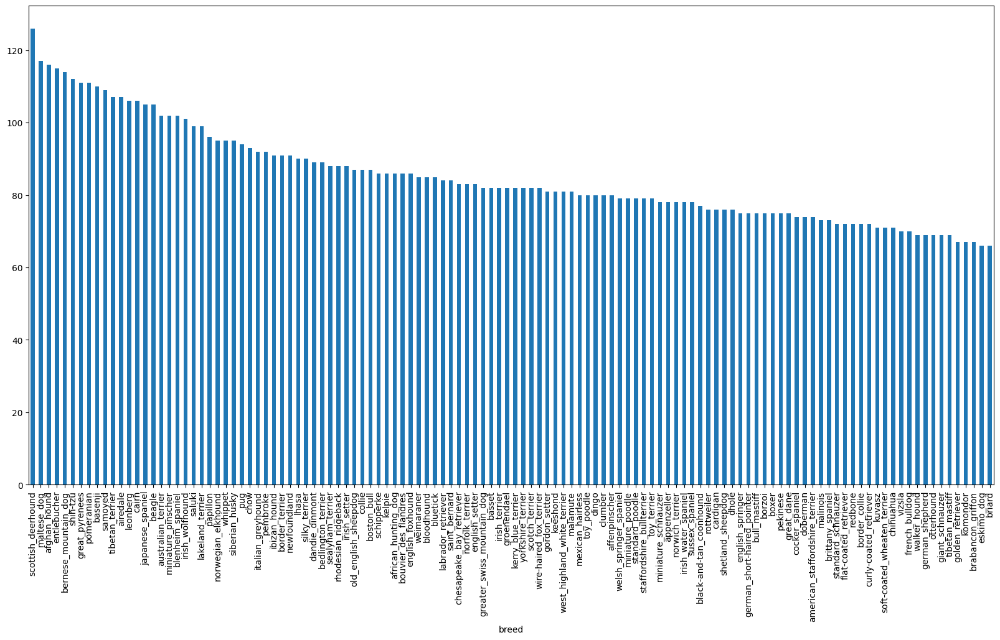

In [11]:
labels_csv.breed.value_counts().plot.bar(figsize=(20,10))

In [12]:
labels_csv.breed.value_counts().median()

82.0

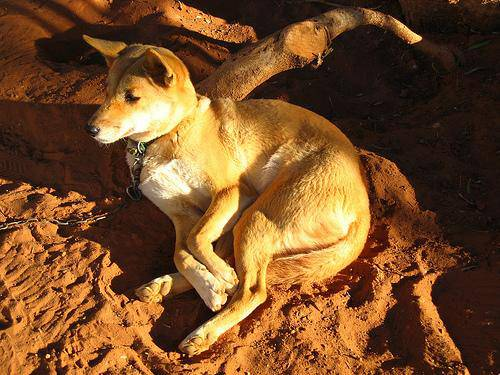

In [13]:
# let's view an image
from IPython.display import Image
Image('/content/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg')

### Getting images and labels in a list type

In [14]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [15]:
# Create pathnames from image ID's
filenames = ['/content/train/'+ fname for fname in labels_csv['id']+ '.jpg']


# Check the first 10
filenames

# # visual image of all
# Image(filenames[:10])

['/content/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/train/0042188c895a2f14ef64a918ed9c7b64.jpg',
 '/content/train/004396df1acd0f1247b740ca2b14616e.jpg',
 '/content/train/0067dc3eab0b3c3ef0439477624d85d6.jpg',
 '/content/train/00693b8bc2470375cc744a6391d397ec.jpg',
 '/content/train/006cc3ddb9dc1bd827479569fcdc52dc.jpg',
 '/content/train/0075dc49dab4024d12fafe67074d8a81.jpg',
 '/content/train/00792e341f3c6eb33663e415d0715370.jpg',
 '/content/train/007b5a16db9d9ff9d7ad39982703e429.jpg',
 '/content/train/007b8a07882822475a4ce6581e70b1f

In [16]:
# Check whether number of filenames matches number of actual image files
import os
if len(os.listdir('/content/train/')) == len(filenames):
  print('Filenames match actual amount of files() Proceed ')
else:
  print('Filenames do not match the actual amount of files, check the target direcrtory ')

Filenames match actual amount of files() Proceed 


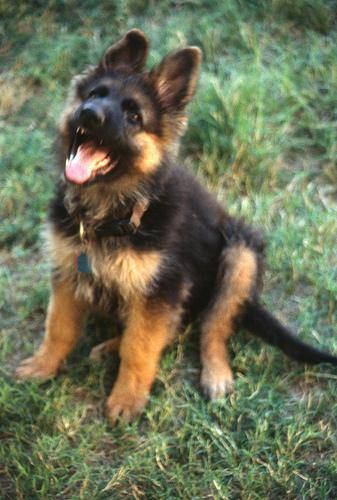

'german_shepherd'

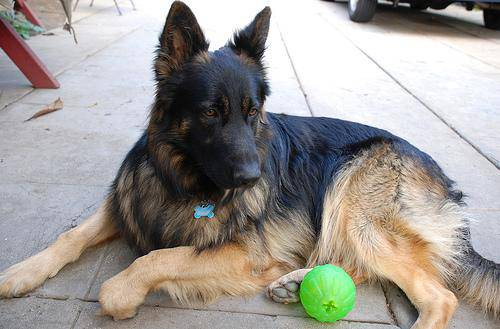

'german_shepherd'

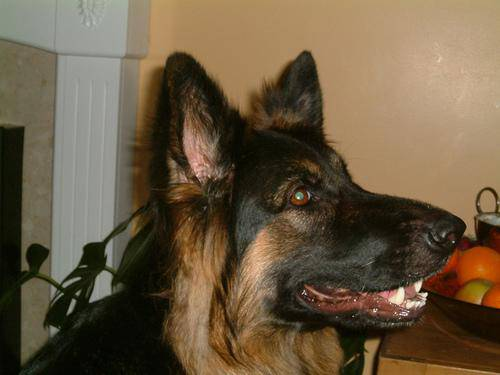

'german_shepherd'

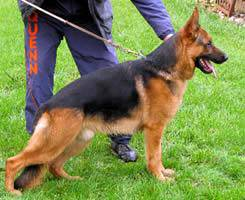

'german_shepherd'

In [17]:
k=1
for i in filenames[1:550]:
  if(labels_csv.breed[k]=='german_shepherd'):
    display(Image(i),labels_csv['breed'][k])
  k=k+1

Since we've now got our trainig image filepaths is set
So let's prepare our Labels.

In [18]:
import numpy as np
labels = labels_csv['breed'].to_numpy()
# labels = np.array[labels]

labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [19]:
# Find the unique label values
unique_breeds = np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [20]:
# Turn a single label into an array of booleans
print(labels[-3])
labels[-3]== unique_breeds # This makes the array checking for every unique breeds

airedale


array([False, False, False,  True, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [21]:
# Turn every label into a boolean array
boolean_labels= [label == unique_breeds for label in labels]
boolean_labels[:3]
len(boolean_labels)

10222

In [22]:
# Example: Turning boolean array into integers
print(labels[0]) # Original label
print(np.where(unique_breeds == labels[0])) # index where label occurs
print(boolean_labels[0].argmax())  # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # there will be a 1 where the sample label occurs.

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [23]:
print(labels[2])

pekinese


### Creating our own vallidaton set.
Since the dataset from kaggle doesn't come with a vaidaton set.

In [24]:
# Setup the dataset from kaggle as x and y variable .
x= filenames
y= boolean_labels

We're going to start off experimenting with 1000 images and images and increase as needed.

In [25]:
# Sejting the no of images for experimenting
num_images = 1000 #@param { type:'slider', min:100, max:1000}

In [26]:
# Let's split our data into train and validation sets
from sklearn.model_selection import train_test_split

# Split them into training and validation of total size
x_train, x_val , y_train, y_val = train_test_split(x[:num_images],
                                                   y[:num_images],
                                                   test_size=0.2,
                                                   random_state=42)

## Preprocessing Images (turning images into Tensors)
To preprocess our images into Tensors we're going to write a function which does a few things:
1. Take an image filepath as input
2. Use TensorFlow to read file and save it to a variable 'image'
3. Turn our 'image' (a jpg) into Tensors.
4. Normalize our image(convert color channel values from 0-255 to 0-1).
5. Resize the 'image' to be a shape of (224,224)
Return the modified images...

Before we do, let's see how a tensor is different from images.

In [27]:
# Convert image to Numpy array
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

In [28]:
# image has an array with values between 0 to 255
image.max(), image.min()

(np.uint8(255), np.uint8(0))

In [29]:
image[:2]

array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)

In [30]:
# Define image size
IMG_SIZE= 224

# Create a function for preprocessing image
def process_image(image_path,img_size= IMG_SIZE ):
  """
  Takes an image file path and turn the image into a Tensor.
  """
  # Read in an image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numericak Tensor with 3 color channel(R G B)
  image = tf.image.decode_jpeg(image, channels =3)
  # Convert the colour channel values from 0-255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired value(224, 224)
  image = tf.image.resize(image, size= [IMG_SIZE, IMG_SIZE])

  return image

In [31]:
# tensor = tf.io.read_file(filenames[6])
# tensor  # Converting the content into long tensor flow in string format .

In [32]:
# tensor= tf.image.convert_image_dtype(tensor, tf.float32)
# tensor

In [33]:
# tensor = tf.image.decode_jpeg(tensor, channels=3)

## Turning our data into batches

Why turn our data into batches?

Let's say if we are trying to process 10k+ images in one time... they will might not fit into memory.

So that's why we do about 32(Batch size) images at a time (you can manually adjust the batch size if need be).

In order to use TensorFlow effectively, we need our data in the form of Tensor tuples which look like this:
'(image, label)'.

In [34]:
# Create a simple function to return a tuple(image, label)
def get_image_label(image_path, label):
  '''
  Takes an image file path name and the assosciated label,
  processes the amage and returns a tuple of (image, label).
  '''
  image = process_image(image_path)
  return image, label

In [35]:
# Demo of the above
(process_image(x[42]),tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now we've got a way to turn our data into tuples of Tesors in the form: (image, label), Let's make a function to turn all of our data(x & y) into batches!

In [36]:
# Define the batch size, 32 is a good start
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches (x, y=None, batch_size= BATCH_SIZE, valid_data= False, test_data = False):
  '''
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle if it's validation data.
  Aslo accepts test data as imput (no labels).
  '''
  # If the data is a test dataset, we probably don't have labels
  if test_data:
    print("Creating test data batches....")
    data= tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  # if the data is a valid dataset , we don't need to shuffle it
  elif valid_data:
    print('Creating validation data batches....')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch
  else: # Training batch
    print('Creating training data batches...')
    # turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    # Shuffling pathnames and labels before mapping image proccessor function is
    data =  data.shuffle(buffer_size=len(x))

    data = data.map(get_image_label) # get image label because it has labels with the data .

    # Turn the training data into batches
    data_batch = data.batch(BATCH_SIZE)

  return data_batch


In [37]:
# Create training and validation data batches
train_data = create_data_batches(x_train, y_train)
val_data= create_data_batches(x_val, y_val, valid_data= True)

Creating training data batches...
Creating validation data batches....


In [38]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing Data Batches

Our data is now in batches, however, these can be alittle hard to understand/comprehend, let's visualize them

In [39]:
import matplotlib.pyplot as plt

# Create a function for viewing  images in a data batch
def show_25_images(images, labels):
  '''
  Displays a plot of 25 images and their labels from a data batch.
  '''
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows and 5 cols)
    ax =plt.subplot(5, 5, i+1)

    # Display in an mpgat
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn the greed lines off
    plt.axis('off')

In [40]:
# train_images, traikn_labels = mi
train_images, train_labels = next(train_data.as_numpy_iterator())
train_images, train_labels

(array([[[[0.42215773, 0.6195579 , 0.26575866],
          [0.30163723, 0.50316983, 0.12591873],
          [0.28599793, 0.49260685, 0.08716331],
          ...,
          [0.28921166, 0.45872533, 0.10568696],
          [0.38546044, 0.5367536 , 0.21162343],
          [0.44324586, 0.57364666, 0.27836436]],
 
         [[0.3856611 , 0.5856611 , 0.2213498 ],
          [0.31695732, 0.51696396, 0.15104769],
          [0.27693805, 0.4775333 , 0.10903542],
          ...,
          [0.26907712, 0.5123313 , 0.14845388],
          [0.31881732, 0.5439747 , 0.20982772],
          [0.26658726, 0.47150442, 0.16925587]],
 
         [[0.40844664, 0.60834044, 0.24548385],
          [0.21488957, 0.41096452, 0.06338749],
          [0.23117718, 0.42403725, 0.10893454],
          ...,
          [0.33442765, 0.51360273, 0.19031586],
          [0.28469416, 0.44417393, 0.15618959],
          [0.19678937, 0.34038913, 0.07477202]],
 
         ...,
 
         [[0.23854429, 0.41797   , 0.05500723],
          [0.25290

In [41]:
train_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

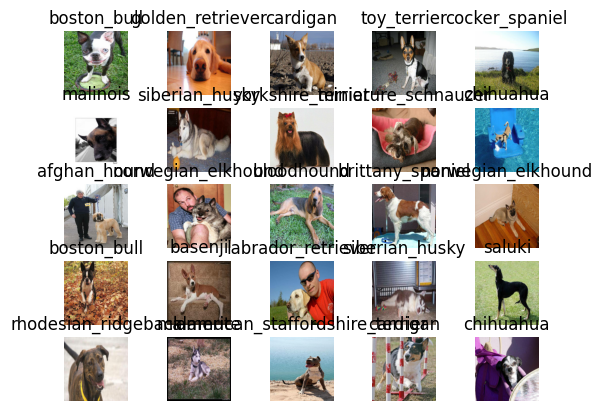

In [42]:
# Now let's visualize the data in a training batch
show_25_images(train_images, train_labels )

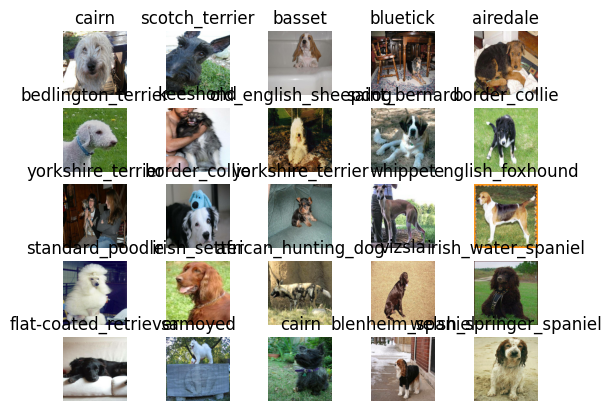

In [43]:
# Now let's visualize our validation set
val_images , val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Building a model

Before we build a model, there are few things we need to define:
* The input shape( our images shape, in the form of Tensors) to our model.
* The output shape (image labels, in the form of Tensors ) of our model.
* The URL of the model we want to use.

In [44]:
IMG_SIZE

224

In [45]:
# import kagglehub
# # Download the latest version.
# MODEL_URL=kagglehub.model_download('google/mobilenet-v2/tensorFlow2/130-224-classification/1')

In [46]:
# Setup input shape to the model
INPUT_SHAPE = [ IMG_SIZE, IMG_SIZE, 3] # batch, height, width, color channel

# Setup output shape of our model
OUTPUT_SHAPE = len(unique_breeds)

# # Setup model URL from TensorFlow Hub
# # Using a different MobileNetV2 URL that is compatible with KerasLayer in Sequential models
# MODEL_URL = 'https://www.kaggle.com/models/google/mobilenet-v2/TensorFlow2/130-224-classification/2'

In [47]:
# # Define image size, assuming it's set somewhere in your code
# IMG_SIZE = 224
# # Assume unique_breeds is defined, e.g., unique_breeds = ["Golden Retriever", "Poodle", ...]

# # --- CORRECTED SETUP ---

# # 1. Setup input shape to the model
# # The batch size (None) is usually inferred, so you don't need to specify it here.
# INPUT_SHAPE = (IMG_SIZE, IMG_SIZE, 3) # height, width, color channel

# # 2. Setup output shape of our model
# OUTPUT_SHAPE = len(unique_breeds)

# # 3. Use a FEATURE VECTOR model URL from TensorFlow Hub
# # This model outputs image features, not final predictions, which is what we need.
# MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_100_224/feature_vector/5"



Now we've got our inputs, outputs and model ready to go.
Let's put them together into a Keras deep learning mdoel!

Knowing this, let's create a function which:
* Takes the input shape, output shape and the model we've chosen as parameters.
* Defines the layers in a kereas model  in sequential fashion (do this first, then this, then that).
* Compiles the model (says it should be evaluated and improved) .
* Builds the model (tell the model the input shape it'll be getting).
* Returns the model.
All of this steps can be found [here](https://www.tensorflow.org/guide/keras/overview)

In [48]:
# #  function which builds a Keras model
# def create_model (input_shape = INPUT_SHAPE,
#                   output_shape = OUTPUT_SHAPE,
#                   model_url=MODEL_URL):
#   print("Building model with: ",MODEL_URL)
#   # Setup the model layers
#   model = tf.keras.Sequential([
#       hub.KerasLayer(MODEL_URL, input_shape=INPUT_SHAPE), # Layer 1 (input layer)
#       # tf.keras.layers.Dense(units= OUTPUT_SHAPE,
#                             # activation='softmax')# Layer 2 (output layer)
#   ])
#   # Compile the model
#   model.compile(
#       loss= tf.keras.losses.CategoricalCrossentropy(),
#       optimizer=tf.keras.optimizers.Adam(),
#       metrics=['accuracy']
#   )

#   # Build the model
#   model.build(INPUT_SHAPE)

#   return model

In [49]:
# def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
#   """
#   Builds a Keras model for transfer learning.
#   """
#   print("Building model with feature extractor from:", model_url)

#   # Setup the model layers
#   model = tf.keras.Sequential([
#       # Use the feature vector model from TF Hub.
#       # Set trainable=False to freeze the pre-trained weights.
#       hub.KerasLayer(model_url,
#                      trainable=False, # Freeze the base model layers
#                      name='feature_extraction_layer',
#                      input_shape=input_shape),

#       # Add our own custom output layer
#       tf.keras.layers.Dense(output_shape,
#                             activation='softmax',
#                             name='output_layer')
#   ])

#   # Compile the model
#   model.compile(
#       loss=tf.keras.losses.CategoricalCrossentropy(),
#       optimizer=tf.keras.optimizers.Adam(),
#       metrics=['accuracy']
#   )

#   return model



In [50]:
# import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.applications import MobileNetV2

# (Keep your setup variables the same)
# IMG_SIZE = 224
# unique_breeds = ["Golden Retriever", "Poodle", "Beagle"] # Example
# INPUT_SHAPE = (IMG_SIZE, IMG_SIZE, 3)
# OUTPUT_SHAPE = len(unique_breeds)


def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE):
  """
  Builds a Keras model using tf.keras.applications.MobileNetV2.
  This is the recommended, stable way to do transfer learning.
  """
  print("Building model with tf.keras.applications.MobileNetV2")

  # 1. Instantiate the base model with pre-trained weights from ImageNet.
  # `include_top=False` removes the original classification layer.
  base_model = MobileNetV2(input_shape=input_shape,
                           include_top=False, # Crucial for transfer learning
                           weights='imagenet')

  # 2. Freeze the base model to prevent its weights from being updated
  base_model.trainable = False

  # 3. Create the new model layers on top of the base model's output
  inputs = Input(shape=input_shape, name="input_layer")

  # The base model contains batch norm layers, which should be run in inference mode
  # when the base model is frozen.
  x = base_model(inputs, training=False)

  # 4. Add a pooling layer to flatten the features
  x = GlobalAveragePooling2D(name="global_average_pooling")(x)

  # 5. Add the final classification layer
  outputs = Dense(output_shape, activation="softmax", name="output_layer")(x)

  # 6. Construct the final model
  model = Model(inputs, outputs)

  # Compile the model
  model.compile(
      loss='categorical_crossentropy',
      optimizer=tf.keras.optimizers.Adam(),
      metrics=['accuracy']
  )

  return model

# Create the model
model = create_model()

# View the model structure
model.summary()

Building model with tf.keras.applications.MobileNetV2
9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling          │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output_layer (Dense)            │ (None, 120)            │       153,720 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,411,704 (9.20 MB)

 Trainable params: 153,720 (600.47 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

In [51]:
# model = create_model()
# model.summary()

## Training the model

Now we've got our data in batches and our model built, it's time to train it.

We can train our model using the `fit()` method.

In [52]:
# Train the model
history = model.fit(train_data,
                    epochs=5, # Train for 5 epochs
                    validation_data=val_data)

Epoch 1/5
25/25 ━━━━━━━━━━━━━━━━━━━━ 33s 685ms/step - accuracy: 0.0454 - loss: 4.8369 - val_accuracy: 0.2200 - val_loss: 3.5865
Epoch 2/5
25/25 ━━━━━━━━━━━━━━━━━━━━ 1s 59ms/step - accuracy: 0.6110 - loss: 2.1998 - val_accuracy: 0.4150 - val_loss: 2.4566
Epoch 3/5
25/25 ━━━━━━━━━━━━━━━━━━━━ 1s 59ms/step - accuracy: 0.9031 - loss: 0.9680 - val_accuracy: 0.5000 - val_loss: 1.9323
Epoch 4/5
25/25 ━━━━━━━━━━━━━━━━━━━━ 4s 102ms/step - accuracy: 0.9763 - loss: 0.4968 - val_accuracy: 0.5900 - val_loss: 1.7575
Epoch 5/5
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.9878 - loss: 0.2995 - val_accuracy: 0.5900 - val_loss: 1.6554


## Creating callbacks
--> Callbacks are helper function a model can use during training to do such things as save its progress, check its progress, or stop training early if a model stops improving.  

In Keras, Callback is a python class  to provide specific functionality with a set of methods called at various stages of training(including batch/epoc start and ends ), testing and predicting. Useful to get views on internal states and statistics of the model.

We'll create two callbacks, one for TensorBoard which helps track our models progress and another for early stopping which prevents our model from training for too long.

### TensorBoard Callback

To setup a TensorBoard, we need to do 3 things:
1. Load the TensorBoard notebook extension✅
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's 'fit()' function.
3. Visualize our models training logs with the '%tensorboard' magic function (we'll do this after model training )

In [53]:
# Load TensorBoard notebook extension
%load_ext tensorboard

In [54]:
import datetime

# Create a function to build a tensorboard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir= os.path.join('/content/drive/MyDrive/DataSet/Dog Vision/logs',
                       # Make it so the logs get tracked whenever we run an experiment
                       datetime.datetime.now().strftime('%d/%m/%Y, %H:%M:%S'))
  return tf.keras.callbacks.TensorBoard(logdir)


### Early stopping callback
This is to monitor if the model is not overfitted and stopping it for [more](https://keras.io/api/callbacks/early_stopping/)

In [55]:
# Create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                                  patience=3)

## Training a model(on subset of data)

Our first model is only going to train on 1000 images, to make sure everything is working.

In [56]:
NUM_EPOCHS = 100 #@param {type:'slider',min:10,max:100}

In [57]:
# Check to make sure we're still running on a gpu
print('GPU', 'available (YES!!!!)' if tf.config.list_physical_devices("GPU") else "not available")

GPU available (YES!!!!)


Let's Create a function which trains a model.

* Create a model using 'create_model()'
* Setup a TensorBoard callback using 'crate_tensorboard_callback()'
* Call the 'fit()' function on our model passing it the training data, validation data, number of epochs to train for ('NUM_EPOCES') and the callback we'd like to use
* Return the model


In [58]:
# Build a function to train and return a trained model
def train_model():
  '''
  Trains a given model and returns the trained version.
  '''
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data, # The batch data which contains data and label
            epochs=NUM_EPOCHS,  # How many times to look training data to find patterns.
            validation_data= val_data,
            validation_freq=1,# How often we wanted to test the patterns
            callbacks=[tensorboard, early_stopping])
  # REturn the fitted the model
  return model

In [59]:
# Fit the model to the data
model = train_model()

Building model with tf.keras.applications.MobileNetV2
Epoch 1/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 361ms/step - accuracy: 0.0558 - loss: 4.8783 - val_accuracy: 0.2350 - val_loss: 3.5611
Epoch 2/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 8s 58ms/step - accuracy: 0.5906 - loss: 2.2520 - val_accuracy: 0.4650 - val_loss: 2.3540
Epoch 3/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 59ms/step - accuracy: 0.8756 - loss: 0.9902 - val_accuracy: 0.5550 - val_loss: 1.8837
Epoch 4/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - accuracy: 0.9677 - loss: 0.5116 - val_accuracy: 0.5900 - val_loss: 1.7069
Epoch 5/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step - accuracy: 0.9939 - loss: 0.2893 - val_accuracy: 0.6050 - val_loss: 1.5863
Epoch 6/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.9992 - loss: 0.2153 - val_accuracy: 0.5950 - val_loss: 1.5432
Epoch 7/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 97ms/step - accuracy: 0.9993 - loss: 0.1557 - val_accuracy: 0.6200 - val_loss: 1.5127
Epoch 8/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/s

**Question:** It looks like our model is overfitting because it's performing far better on the training dataset than the validation dataseet, what are some ways to prevent model overfitting in deep learning neural networks?

**Note:** Overfitting to begin with is a good thing! It means our model is learning!!!!!11

### Checking the TensorBoard logs

The TensorBoard magic function ('%tensorboard') will access the logs directory we created earlier and visualize its contents.


In [60]:
%tensorboard --logdir /content/drive/MyDrive/DataSet/Dog\ Vision/logs

<IPython.core.display.Javascript object>

### Making and Evaluating prediction using a trained model

In [61]:

# Make predictions on the validation data (not used to train on )
predictions =model.predict(val_data, verbose=1)
predictions

7/7 ━━━━━━━━━━━━━━━━━━━━ 9s 763ms/step


array([[7.7314157e-04, 8.2607678e-04, 2.5766890e-04, ..., 2.3323041e-04,
        8.3643463e-05, 5.9242854e-03],
       [2.0046483e-04, 1.1683875e-03, 1.4137557e-03, ..., 1.2934059e-04,
        1.0756680e-02, 4.7025277e-04],
       [9.2263454e-06, 9.2996983e-04, 8.3053907e-05, ..., 9.9328397e-05,
        1.2606379e-04, 3.0475354e-03],
       ...,
       [6.5231556e-04, 8.7269867e-04, 5.1482691e-04, ..., 8.8820729e-04,
        6.2221626e-04, 1.0086289e-03],
       [7.0740003e-04, 1.9165708e-04, 3.0771634e-04, ..., 4.3988442e-05,
        9.2723058e-05, 1.6023269e-02],
       [8.9859008e-05, 2.6278036e-05, 2.8034381e-04, ..., 4.1474632e-04,
        8.3373679e-04, 1.7405832e-03]], dtype=float32)

In [62]:
predictions.shape

(200, 120)

In [63]:
len(y_val)

200

In [64]:
# First Prediction
index=42
print(predictions[0])
print(f" Max value (probabillity of prediction):{ np.max(predictions[index])}")
print(f"Sum: {np.sum(predictions[index])}")
print(f"max index: {np.argmax(predictions[index])}")
print(f"Predicted label:{unique_breeds[np.argmax(predictions[index])]}")

[7.7314157e-04 8.2607678e-04 2.5766890e-04 9.8464161e-04 2.4648377e-04
 2.2914899e-04 4.6127844e-03 4.2105030e-04 6.1860261e-04 1.2275625e-04
 2.7912619e-04 2.9362543e-04 7.5753465e-05 1.8503683e-04 9.5341180e-04
 1.0010497e-04 3.7409067e-05 3.3589730e-03 3.6203619e-05 1.9029397e-04
 8.3171140e-04 1.8272855e-04 7.7803692e-05 6.2959245e-04 8.0278769e-06
 9.3633280e-05 3.2434862e-02 6.9658367e-05 8.0168835e-04 1.8189607e-04
 4.7693939e-05 2.5040151e-03 4.2229515e-04 1.8128354e-04 1.5949146e-04
 4.4330261e-03 7.0882772e-05 1.5402188e-04 6.9666341e-05 1.4681432e-05
 1.3975827e-03 1.5533815e-05 1.4091258e-04 4.0634119e-04 3.4944783e-04
 2.2517145e-04 6.1618757e-06 2.6400507e-04 1.2179057e-03 4.5421749e-04
 3.1958389e-05 1.3256114e-04 7.3670791e-03 5.8583311e-05 3.8357270e-05
 1.8538638e-05 6.7383080e-05 1.8200817e-03 2.1325270e-04 4.9244039e-02
 4.4623273e-04 2.7190923e-04 1.2719487e-04 1.1068728e-04 4.1483733e-04
 3.9583282e-03 5.4548244e-04 2.2958453e-05 7.0120194e-03 4.5759552e-05
 3.991

In [65]:
unique_breeds[39]

'english_foxhound'

Having the above functionality is great but we want to be able to do it at scale.
And it would be even better if we could see the image prediction is being made on

**Note:**Prediction probability are also known as confidence levels.

In [66]:
# turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turn an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax (prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[81])
pred_label

'chihuahua'

In [67]:
predictions.shape

(200, 120)

Now since our validation data is still in a batch dataset, we'll have to unbatchify it to make predictions on the validations images and then compare those predictions to the validation labels(truth labels).

In [68]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [69]:
# Create a function to unbatch a batch dataset
def unbatchify(data):
  '''
  Takes a batched dataset of (image, label) Tensors and returns seperate arrays
  of images and labels.
  '''
  images= []
  labels= []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [70]:
images_ =[]
labels_ =[]

# Loop through unbatched data
for image, label in val_data.unbatch().as_numpy_iterator():
  images_.append(image)
  labels_.append(label)
images_[0], labels_[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

Now we've got ways to get :
* Prediction labels
* Validation labels (truth labels)
* Validation Images

Let's make some function to make these all a bit more visualize

We'll create a function which:
* Takes an array of prediction probabilities, an array of truth labels and an array of images and integers.
* Convert the prediction probabilities to a predicted label.
* Plot the predicted label, its predicted probability, the truth label and the target image on a single plot.


In [71]:
# function to plot predicted probability
def plot_pred(prediction_probabilities, labels, images, n=1):
  '''
  View the prediction, ground truth and image for sample n
  '''
  pred_prob, true_label, image= prediction_probabilities[n], labels[n], images[n]

  # Plot image & remove ticks
  pred_label = get_pred_label(pred_prob)
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = 'green'
  else:
    color='red'

  # Change plot title to be predicted, probability of prediction and truth label
  plt.title("Predicted ={} {:2.0f} True= {}".format(pred_label,
                                                    np.max(pred_prob)*100,
                                                    true_label),
                                                    color= color)




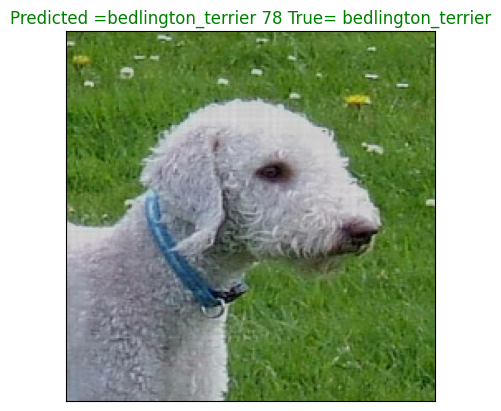

In [72]:
plot_pred(prediction_probabilities= predictions, labels= val_labels, images=val_images, n=5)

In [73]:
# Create a function to show a batch of images with their prediction
def show_image_predictions(images, labels, predictions):
  '''
  Displays a plot of 25 images with their predicted and true labels.
  '''
  # Set the figure size before the loop
  plt.figure(figsize=(15,350))
  # Loop through 25 (for displaying 25 images)
  for i in range(200):
    # Create subplots (5 rows and 5 cols)
    ax = plt.subplot(40, 5, i+1)

    # Display in an mpgat
    plt.imshow(images[i])

    # Get the predicted label
    pred_label = get_pred_label(predictions[i])

    # Get the true label
    true_label = labels[i]

    # Set the title color based on if the prediction is right or wrong
    color = "green" if pred_label == true_label else "red"

    # Add the image label as the title
    plt.title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

    # Turn the greed lines off
    plt.axis('off')

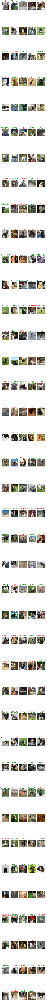

In [74]:
show_image_predictions(val_images,val_labels,predictions)

In [75]:
# Save the figure to Google Drive
plt.savefig('/content/drive/MyDrive/dog_breed_predictions.png')

<Figure size 640x480 with 0 Axes>

Now we've got one function to visualize our models top prediction, let's make another to view our models top 10 predict

This function will:
* Take an input of prediction probabilities array and a ground truth array and an np.integer
* Find the prediction using 'get_pred_label()'
* Find the top 10 :
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels

* Plot the top 10 prediction probability values and labels, coloring the true label green.


In [76]:
def plot_pred_conf( prediction_probabilities, labels, n=1):
  '''
  Plot the top 10 highest prediction confidence along with the truth label for sample n.
  '''
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color ='grey')

  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels = top_10_pred_labels,
             rotation = 'vertical')
  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color('g')
  else:
    pass

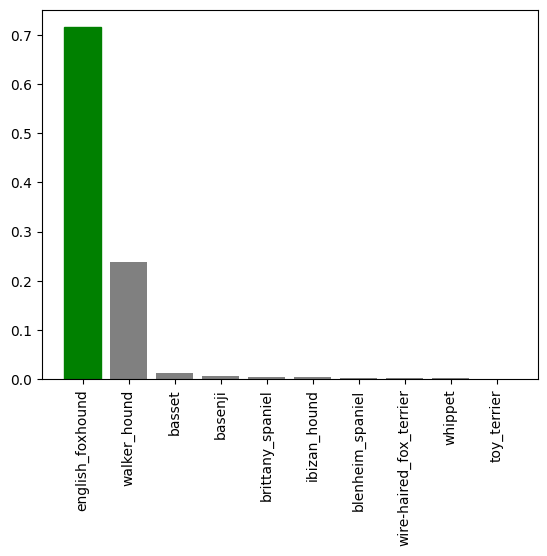

In [77]:
plot_pred_conf(prediction_probabilities=predictions,
               labels = val_labels,
               n=90)

In [78]:
predictions[0][predictions[0].argsort()[-10:][::-1]]

array([0.39914936, 0.14434619, 0.1281084 , 0.04924404, 0.04321091,
       0.04233829, 0.03351417, 0.03243486, 0.01876315, 0.01537683],
      dtype=float32)

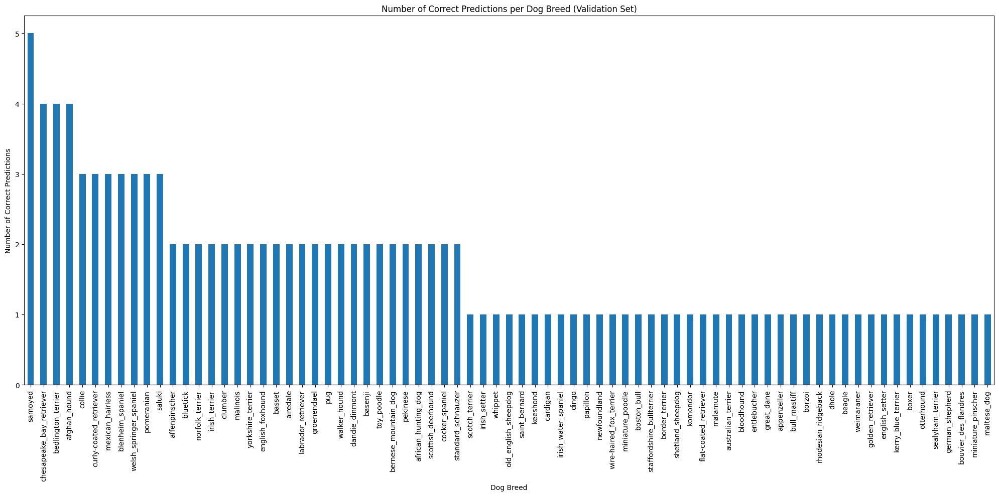

In [79]:
# Get predicted labels for the validation set
predicted_labels = [get_pred_label(pred) for pred in predictions]

# Create a list of correctly predicted breed names
correct_predictions_list = [val_labels[i] for i in range(len(val_labels)) if predicted_labels[i] == val_labels[i]]

# Get the value counts of correctly predicted breeds
correct_prediction_counts = pd.Series(correct_predictions_list).value_counts()

# Create a bar graph of correct prediction counts
plt.figure(figsize=(20, 10))
correct_prediction_counts.plot(kind='bar')
plt.xticks(rotation=90)
plt.xlabel("Dog Breed")
plt.ylabel("Number of Correct Predictions")
plt.title("Number of Correct Predictions per Dog Breed (Validation Set)")
plt.tight_layout()
plt.show()

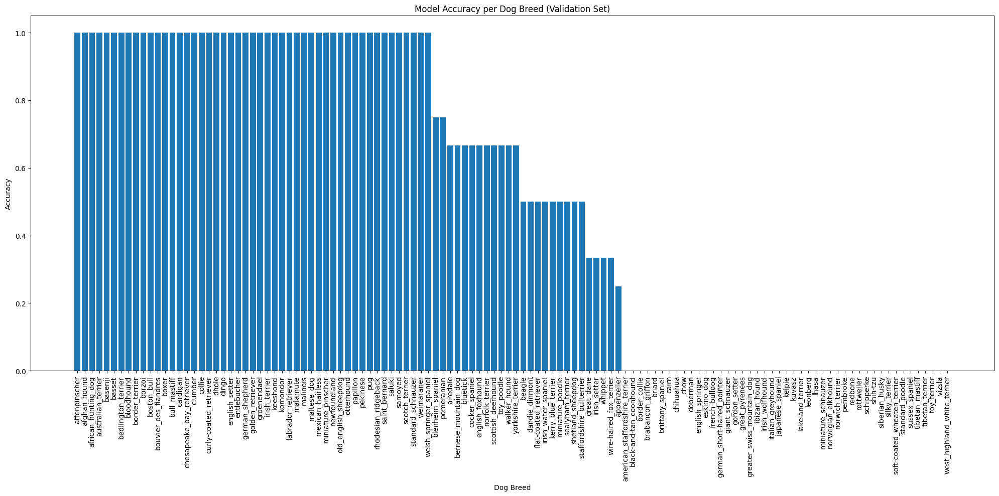

In [80]:
# Calculate accuracy for each breed
breed_accuracies = {}
for i, breed in enumerate(unique_breeds):
    # Get indices where the true label is the current breed
    breed_indices = [j for j, label in enumerate(val_labels) if label == breed]
    if breed_indices:
        # Get predictions and true labels for the current breed
        breed_predictions = predictions[breed_indices]
        breed_true_labels = [val_labels[j] for j in breed_indices]

        # Get predicted labels
        breed_predicted_labels = [get_pred_label(pred) for pred in breed_predictions]

        # Calculate accuracy
        correct_predictions = sum([1 for true, pred in zip(breed_true_labels, breed_predicted_labels) if true == pred])
        accuracy = correct_predictions / len(breed_indices)
        breed_accuracies[breed] = accuracy
    else:
        breed_accuracies[breed] = 0

# Sort breeds by accuracy in descending order
sorted_breeds = sorted(breed_accuracies.items(), key=lambda item: item[1], reverse=True)

# Extract sorted breed names and accuracies
sorted_breed_names = [item[0] for item in sorted_breeds]
sorted_breed_accuracies = [item[1] for item in sorted_breeds]

# Create a bar graph
plt.figure(figsize=(20, 10))
plt.bar(sorted_breed_names, sorted_breed_accuracies)
plt.xticks(rotation=90)
plt.xlabel("Dog Breed")
plt.ylabel("Accuracy")
plt.title("Model Accuracy per Dog Breed (Validation Set)")
plt.tight_layout()
plt.show()

Now we've got some function to help us visulaize our predictions and evaluate our model, let's check out a few.

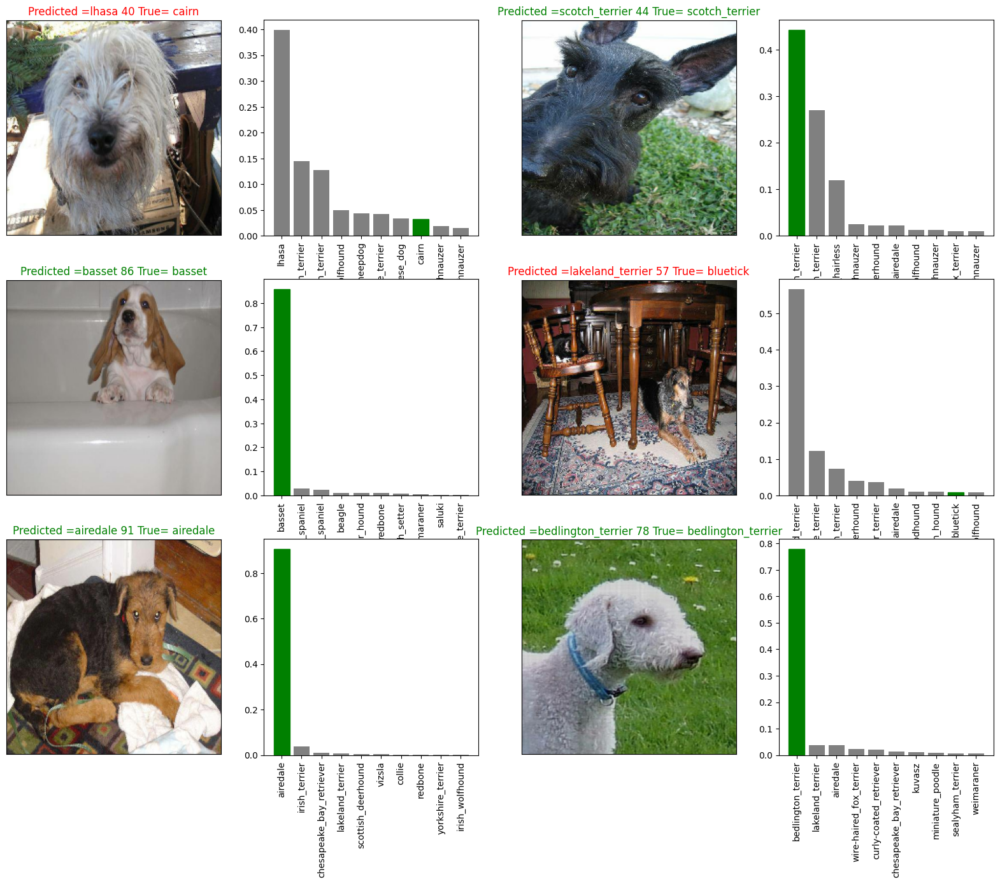

In [81]:
# Let's check out a few predictions and their different values
i_multiplier =0
num_rows= 3
num_cols= 2
num_images = num_rows*num_cols
plt.figure(figsize=(10*num_cols,5*num_rows))
for i in range (num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images= val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels= val_labels,
                 n=i+i_multiplier)
plt.show()


**Challenge** Create a confusion matrix with our models predictions and true labels

### Saving and Loading Models

In [82]:
# Create a function to save a model
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (string)
  """
  # Create a model directory pathname with current time
  modeldir = os.path.join('drive/My Drive/Dog Vision/models',
                          datetime.datetime.now().strftime('%d%m%Y-%H%M%S'))
  model_path = modeldir + '-' +suffix + '.h5' # h5 extension format of model

  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [83]:
# Create a function to load a trained model
def load_model(model_path):
  '''
  Loads a saved model from a specified path.
  '''
  print (f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={'KerasLayer':hub.KerasLayer})
  return model

NOw we've got functions to save and load a trained model, let's make sure they work!

In [84]:
# Savve our model trained on 1000 images
save_model(model, suffix ='1000-images-mobilenetv2-Adam')

Saving model to: drive/My Drive/Dog Vision/models/08102025-061021-1000-images-mobilenetv2-Adam.h5...


'drive/My Drive/Dog Vision/models/08102025-061021-1000-images-mobilenetv2-Adam.h5'

# Training a big data model

In [85]:
len(x), len(y)

(10222, 10222)

In [86]:
# Create a data batch with the fulll data set
full_data = create_data_batches(x,y)


Creating training data batches...


In [87]:
full_data


<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [88]:
# Create a model for full model
full_model = create_model()

Building model with tf.keras.applications.MobileNetV2


In [89]:
# Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()
# No validation set when training on all the data,
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor= 'accuracy',
                                                             patience = 3)

**Note:** Running the cell below will take a little while (maybe up to 30 minutes for the first epoch) because the GPU we're using in the runtime has

In [90]:
from numbers import Number
# Fit the full model to the full data
full_model.fit(x=full_data,
               epochs= NUM_EPOCHS,
               callbacks=[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 39s 89ms/step - accuracy: 0.4458 - loss: 2.5002
Epoch 2/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 19s 58ms/step - accuracy: 0.8364 - loss: 0.5824
Epoch 3/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 18s 52ms/step - accuracy: 0.9035 - loss: 0.3668
Epoch 4/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 17s 53ms/step - accuracy: 0.9480 - loss: 0.2436
Epoch 5/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 17s 53ms/step - accuracy: 0.9648 - loss: 0.1833
Epoch 6/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 18s 56ms/step - accuracy: 0.9836 - loss: 0.1293
Epoch 7/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 17s 54ms/step - accuracy: 0.9915 - loss: 0.0974
Epoch 8/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 17s 53ms/step - accuracy: 0.9940 - loss: 0.0791
Epoch 9/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 20s 52ms/step - accuracy: 0.9975 - loss: 0.0626
Epoch 10/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 21s 53ms/step - accuracy: 0.9978 - loss: 0.0485
Epoch 11/100
320/320 ━━━━━━━━━━━━━━━━━━━━ 17s 53ms/step - accuracy: 0.9982 - loss: 0.0413
Epoch 12/100
320/32

In [91]:
save_model(full_model, suffix ="full-image-set-mobilenetv2-Adam")

Saving model to: drive/My Drive/Dog Vision/models/08102025-062104-full-image-set-mobilenetv2-Adam.h5...


'drive/My Drive/Dog Vision/models/08102025-062104-full-image-set-mobilenetv2-Adam.h5'

In [92]:
loaded_full_model =load_model('drive/My Drive/Dog Vision/models/08102025-062104-full-image-set-mobilenetv2-Adam.h5')

Loading saved model from: drive/My Drive/Dog Vision/models/08102025-062104-full-image-set-mobilenetv2-Adam.h5


## Making prediction on full data set..

Since our modelhas been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format...

Luckilly we created 'create_data_batches()' earlier which can take a list of filenames as input and conver then into Tensor batches.

To make predictions on the test data, we'll:
* Get the test image filenames
* convert the filenames into test data batches using 'create_data_batches()'  and setting the 'test_data' parameter to 'True' (since the test data doesn't have labels).
* Make a predictions array by passing the test batches to the 'predict()' method called on our model.

In [105]:
# load the test image filenames
test_path ='/content/test/'
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['/content/test/ece4530999e8c3ec85d2a86d33f07e37.jpg',
 '/content/test/bbcd36509154211f65e76bdf7e02df43.jpg',
 '/content/test/b6614b9f9276022bb19f7e6bf69d2c42.jpg',
 '/content/test/fa770328b53a68589a12b6f059099ee8.jpg',
 '/content/test/f495e4dbc5b2bc6230bca03970d37876.jpg',
 '/content/test/73c5bd5a85935013a39564fad43e7592.jpg',
 '/content/test/31fd12dd573f80fa94f7d8330b57f563.jpg',
 '/content/test/11754ee6d33fceb7a8dab2c33f3ba008.jpg',
 '/content/test/e05367db91d0449b2afe76a1b7acc1c8.jpg',
 '/content/test/36ad4269f38b87653eb7aeb70101f0ae.jpg']

In [106]:
len(test_filenames)

10357

In [107]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data = True)

Creating test data batches....


In [108]:
test_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

**Note** Calling 'predict()' on our full model and passing it the test data batch will take a long time to run (about an hour)

In [109]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose =1)

324/324 ━━━━━━━━━━━━━━━━━━━━ 33s 90ms/step


In [116]:
np.savetxt("/content/drive/MyDrive/Dog Vision/preds_array.csv", test_predictions, delimiter=',')

In [117]:
test_predictions = np.loadtxt("/content/drive/MyDrive/Dog Vision/preds_array.csv", delimiter=',')

In [118]:
test_predictions[:10]

array([[3.18987978e-12, 1.31414533e-08, 9.69639444e-08, ...,
        9.71603731e-06, 5.00987483e-08, 5.85900288e-08],
       [1.39542038e-07, 2.16800363e-05, 1.25074018e-06, ...,
        9.91852787e-08, 1.05333172e-07, 5.88982818e-09],
       [5.88015858e-10, 5.52344683e-13, 1.02300701e-08, ...,
        4.64124696e-06, 1.41537191e-08, 2.29776980e-08],
       ...,
       [1.68393214e-07, 9.70611145e-05, 6.49093238e-07, ...,
        3.38341465e-07, 7.48240692e-10, 1.97476879e-09],
       [2.80794632e-09, 1.50833053e-08, 4.05025835e-09, ...,
        1.28895681e-06, 1.05777381e-05, 4.65647576e-10],
       [2.10936702e-11, 2.58029620e-09, 1.05813980e-09, ...,
        2.02604614e-10, 8.40570391e-11, 5.19310706e-10]])

In [119]:
test_predictions.shape

(10357, 120)

## Preparing test dataset predictions for Kaggle

Looking at the Kaggle sample submission,
we find that it wants our models prediction probability outputs in DataFrame with an ID and a column for each different dog breed.
And sample [Eavaluation](https://www.kaggle.com/c/dog-breed-identification/overview/evaluation)

To get the data in this format, we'll:
* Create a pandas DataFrame with an ID column as well as a column for each dog breed .
* Add data to the ID column by extracting the test image ID's from their filepaths.
* Add data( the prediction probabilites) to each one of the dog breed columns in(0,1).
* Export the DataFrame as a CSV to submit it to Kaggle.


In [122]:
# Create a pandas DataFrame with empty columns
preds_df = pd.DataFrame (columns =['id']+list(unique_breeds))

In [121]:
# list(unique_breeds)

In [123]:
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [128]:
# Append test image ID's to prediction DataFrame
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]

In [129]:
test_ids

['ece4530999e8c3ec85d2a86d33f07e37',
 'bbcd36509154211f65e76bdf7e02df43',
 'b6614b9f9276022bb19f7e6bf69d2c42',
 'fa770328b53a68589a12b6f059099ee8',
 'f495e4dbc5b2bc6230bca03970d37876',
 '73c5bd5a85935013a39564fad43e7592',
 '31fd12dd573f80fa94f7d8330b57f563',
 '11754ee6d33fceb7a8dab2c33f3ba008',
 'e05367db91d0449b2afe76a1b7acc1c8',
 '36ad4269f38b87653eb7aeb70101f0ae',
 '0e5e614226a9f90dadc315bfba52458f',
 'e6b2cfafb8c0a06c062832369365fa9e',
 'b9d05f41fd8b192e51f4ce5ffae87280',
 '9796f4fee0eecaaee3299598c7d6fefc',
 'df69bb4b3dbdc81541e2bd70a5f35cb1',
 '616c217716688c8aec897cfb3de0efe7',
 '84539cf9ce5a5c51df51800eb1c4876d',
 'd2ceead83f200ec8def073008e7aa915',
 '261698fc6b5ee8d7832993faeab992d6',
 '92fda6c3ace7bba1562e9a42c9632491',
 'b706b182f887ceb117fd378a930d192a',
 '8e2013612b7d0584c9b70a541fed14dd',
 '76a5387819ec20088d467d2c6bfc4790',
 '549f329f80ed9ae64b33aaa2c2fc1eae',
 '8008a55c2ed4d7cc838db7bc4b789dd0',
 'b67414380e9218f96f605f4eceef9fab',
 '3ca5cc54176c11dfbfdd81d4e5c89fa5',
 

In [130]:
preds_df['id']= test_ids

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,ece4530999e8c3ec85d2a86d33f07e37,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,bbcd36509154211f65e76bdf7e02df43,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,b6614b9f9276022bb19f7e6bf69d2c42,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,fa770328b53a68589a12b6f059099ee8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,f495e4dbc5b2bc6230bca03970d37876,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [133]:
# Add the prediction probabilities to each dog breed columns
preds_df[list(unique_breeds)]= test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,ece4530999e8c3ec85d2a86d33f07e37,3.189880e-12,1.314145e-08,9.696394e-08,1.390500e-06,7.199511e-06,7.327324e-06,1.479646e-07,6.427386e-03,1.601807e-02,...,3.282435e-09,6.857240e-08,2.234801e-08,3.611609e-03,5.418792e-09,3.631196e-06,1.164368e-08,9.716037e-06,5.009875e-08,5.859003e-08
1,bbcd36509154211f65e76bdf7e02df43,1.395420e-07,2.168004e-05,1.250740e-06,5.229447e-09,1.056765e-10,1.034078e-08,1.657590e-09,4.358111e-10,1.058570e-07,...,8.746992e-09,1.228941e-09,1.870245e-08,9.546287e-07,3.657937e-08,3.373553e-05,5.079729e-10,9.918528e-08,1.053332e-07,5.889828e-09
2,b6614b9f9276022bb19f7e6bf69d2c42,5.880159e-10,5.523447e-13,1.023007e-08,5.348368e-12,9.135802e-07,2.023881e-07,1.757119e-09,3.008459e-05,8.215614e-08,...,1.391161e-07,9.602385e-01,6.443142e-10,3.352926e-06,4.984372e-08,3.081718e-09,2.706741e-07,4.641247e-06,1.415372e-08,2.297770e-08
3,fa770328b53a68589a12b6f059099ee8,1.723758e-09,9.101536e-09,1.616532e-08,9.488248e-09,1.183720e-08,3.572588e-07,4.613939e-09,7.534760e-07,4.467967e-09,...,2.264835e-08,3.670885e-09,1.864321e-08,3.556058e-05,3.285347e-06,7.170183e-09,1.205807e-07,2.537634e-07,4.407486e-07,1.987094e-08
4,f495e4dbc5b2bc6230bca03970d37876,3.572855e-08,2.301308e-07,3.630214e-08,8.167742e-09,9.205169e-11,1.292401e-09,1.735807e-10,3.394825e-11,5.783701e-10,...,2.699055e-10,3.579212e-12,5.356940e-11,2.189521e-10,1.489758e-10,5.210825e-11,3.463392e-12,3.286611e-09,6.552587e-12,4.153753e-10


In [134]:
# Save our predictions dataframe to csv for submission to Kaggle
preds_df.to_csv("/content/drive/MyDrive/Dog Vision/full_model_predictions_submission_1_mobilenetV2.csv",
                index= False)

## To make prediction on custom images

To make predictions we'll:
* Get the filepaths of downloaded photos .
* Turn the filepaths into data batches using 'create_data_batches()'. And since our custom images won't have labels, we set the 'test_data' parameter to 'True'.
* Pass the custom image data batch to our model's 'predict()' method.
* Convert the prediction output probabilites to predictions labels.
* Compare the predicted labels to the custom images.


In [148]:
# Get the filepaths
custom_path = "/content/drive/MyDrive/Dog Vision/custom_image_dog/"
custom_image_paths= [custom_path + fname for fname in os.listdir(custom_path)]

In [160]:
custom_image_paths[0:5]

['/content/drive/MyDrive/Dog Vision/custom_image_dog/download (1).jpg',
 '/content/drive/MyDrive/Dog Vision/custom_image_dog/download (2).jpg',
 '/content/drive/MyDrive/Dog Vision/custom_image_dog/download (3).jpg',
 '/content/drive/MyDrive/Dog Vision/custom_image_dog/download.jpg',
 '/content/drive/MyDrive/Dog Vision/custom_image_dog/images (1).jpg']

In [161]:
# Turn custom images into batch database
custom_data = create_data_batches(custom_image_paths[:5], test_data =True)
custom_data

Creating test data batches....


<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [162]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)


1/1 ━━━━━━━━━━━━━━━━━━━━ 10s 10s/step


In [164]:
custom_preds.shape

(5, 120)

In [166]:
# Get custom image prediction labels
custom_preds_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_preds_labels

['german_shepherd',
 'tibetan_mastiff',
 'rhodesian_ridgeback',
 'german_shepherd',
 'american_staffordshire_terrier']